<a href="https://colab.research.google.com/github/RitoshreeS/RitoshreeS/blob/main/DAV_Project_Spotify_Genre.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**DATA ANALYSIS AND VISUALISATION PROJECT**
****

**RITOSHREE SARKAR**



** SPOTIFY GENRES DATASET**

 **AIM: To analyze different genres of music and their characteristic features**

**ATTRIBUTES**

1.  **DANCEABILITY**-Describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity.
2.  **ENERGY**-Represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale.
3.  **KEY**-The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on.
4.  **MODE**-Indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.
5.  **SPEECHINESS**-This detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value.
6.  **ACOUSTICNESS**-A confidence measure from 0.0 to 1.0 of whether the track is acoustic.
7.  **INSTRUMENTALNESS**-Predicts whether a track contains no vocals. “Ooh” and “aah” sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly “vocal”.
8.  **LIVENESS**-Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live.
9.  **VALENCE**-Describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).
10. **TEMPO**-The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece, and derives directly from the average beat duration.
11. TYPE
12. GENRE
13. SONG_NAME

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
import os
os.chdir('/content/drive/My Drive')


Mounted at /content/drive/


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import plotly.express as px

In [ ]:
df=pd.read_csv('genres_spotify.csv') #Read the dataset in Colab
pd.set_option('display.max_rows',20)
df.rename(columns={'danceability':'DANCEABILITY','energy':'ENERGY','key':'KEY','loudness':'LOUDNESS','mode':'MODE','speechiness':'SPEECHINESS',
                   'acousticness':'ACOUSTICNESS','instrumentalness':'INSTRUMENTALNESS','liveness':'LIVENESS','valence':'VALENCE','tempo':'TEMPO','type':'TYPE',
                   'id':'ID','uri':'URI','track_href':'TRACK_HREF','analysis_url':'ANALYSIS_URL','duration_ms':'DURATION_MS','time_signature':'TIME_SIGNATURE',
                   'genre':'GENRE','song_name':'SONG_NAME','Unnamed: 0':'UNNAMED NO','title':'TITLE'}, inplace=True)
                                    #Rename column names

df['SONGS']=df['SONG_NAME'].fillna('') + df['TITLE'].fillna('')
df['SONGS'].replace( np.nan, regex=True, inplace=True)

df.drop(columns=['URI','TRACK_HREF','ANALYSIS_URL','UNNAMED NO','SONG_NAME','TITLE','ID','TYPE'],inplace=True)   #Drop columns which are not to be used


<ipython-input-3-af07b7e3ef08>:1: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv('genres_spotify.csv') #Read the dataset in Colab


In [ ]:
print(df.shape)
df.head(8)

(42304, 15)


,DANCEABILITY,ENERGY,KEY,LOUDNESS,MODE,SPEECHINESS,ACOUSTICNESS,INSTRUMENTALNESS,LIVENESS,VALENCE,TEMPO,DURATION_MS,TIME_SIGNATURE,GENRE,SONGS
0,0.831,0.814,2,-7.364,1,0.4200,0.0598,0.013400,0.0556,0.3890,156.985,124539,4,Dark Trap,Mercury: Retrograde
1,0.719,0.493,8,-7.230,1,0.0794,0.4010,0.000000,0.1180,0.1240,115.080,224427,4,Dark Trap,Pathology
2,0.850,0.893,5,-4.783,1,0.0623,0.0138,0.000004,0.3720,0.0391,218.050,98821,4,Dark Trap,Symbiote
3,0.476,0.781,0,-4.710,1,0.1030,0.0237,0.000000,0.1140,0.1750,186.948,123661,3,Dark Trap,ProductOfDrugs (Prod. The Virus and Antidote)
4,0.798,0.624,2,-7.668,1,0.2930,0.2170,0.000000,0.1660,0.5910,147.988,123298,4,Dark Trap,Venom
5,0.721,0.568,0,-11.295,1,0.4140,0.0452,0.212000,0.1280,0.1090,144.915,112511,4,Dark Trap,Gatteka
6,0.718,0.668,8,-4.162,1,0.1370,0.0254,0.007800,0.1240,0.0380,130.826,77584,4,Dark Trap,kamikaze (+ pulse)
7,0.694,0.711,8,-5.525,1,0.2210,0.0397,0.000000,0.1120,0.2830,138.049,127524,3,Dark Trap,T.R.U. (Totally Rotten Underground)


In [ ]:
df.isnull().any()  #Checking for null values

DANCEABILITY        False
ENERGY              False
KEY                 False
LOUDNESS            False
MODE                False
SPEECHINESS         False
ACOUSTICNESS        False
INSTRUMENTALNESS    False
LIVENESS            False
VALENCE             False
TEMPO               False
DURATION_MS         False
TIME_SIGNATURE      False
GENRE               False
SONGS               False
dtype: bool

In [ ]:
list(df.columns)  #Display column names

['DANCEABILITY',
 'ENERGY',
 'KEY',
 'LOUDNESS',
 'MODE',
 'SPEECHINESS',
 'ACOUSTICNESS',
 'INSTRUMENTALNESS',
 'LIVENESS',
 'VALENCE',
 'TEMPO',
 'DURATION_MS',
 'TIME_SIGNATURE',
 'GENRE',
 'SONGS']

In [ ]:
#info(): This function is used to get a concise summary of the dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42304 entries, 0 to 42303
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DANCEABILITY      42304 non-null  float64
 1   ENERGY            42304 non-null  float64
 2   KEY               42304 non-null  int64  
 3   LOUDNESS          42304 non-null  float64
 4   MODE              42304 non-null  int64  
 5   SPEECHINESS       42304 non-null  float64
 6   ACOUSTICNESS      42304 non-null  float64
 7   INSTRUMENTALNESS  42304 non-null  float64
 8   LIVENESS          42304 non-null  float64
 9   VALENCE           42304 non-null  float64
 10  TEMPO             42304 non-null  float64
 11  DURATION_MS       42304 non-null  int64  
 12  TIME_SIGNATURE    42304 non-null  int64  
 13  GENRE             42304 non-null  object 
 14  SONGS             42304 non-null  object 
dtypes: float64(9), int64(4), object(2)
memory usage: 4.8+ MB


In [ ]:
cat = [cols for cols in df if df[cols].dtypes=='O']
num = [cols for cols in df if df[cols].dtypes=='float64']
print('1. Category Columns :',cat)
print('2. Numerical Columns :',num)

1. Category Columns : ['GENRE', 'SONGS']
2. Numerical Columns : ['DANCEABILITY', 'ENERGY', 'LOUDNESS', 'SPEECHINESS', 'ACOUSTICNESS', 'INSTRUMENTALNESS', 'LIVENESS', 'VALENCE', 'TEMPO']


In [ ]:
#describe(): This function shows basic statistical details
df.describe(include=['object','int','string','float'])

,DANCEABILITY,ENERGY,KEY,LOUDNESS,MODE,SPEECHINESS,ACOUSTICNESS,INSTRUMENTALNESS,LIVENESS,VALENCE,TEMPO,DURATION_MS,TIME_SIGNATURE,GENRE,SONGS
count,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304.000000,42304,42304
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,15569
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Underground Rap,Euphoric Hardstyle
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5875,1398
mean,0.639361,0.762516,5.370343,-6.465537,0.549452,0.136559,0.096161,0.283054,0.214083,0.357105,147.472342,250868.459673,3.972579,NaN,NaN
std,0.156618,0.183825,3.666127,2.941135,0.497554,0.126169,0.170829,0.370793,0.175576,0.233202,23.842301,102957.527704,0.268345,NaN,NaN
min,0.065100,0.000243,0.000000,-33.357000,0.000000,0.022700,0.000001,0.000000,0.010700,0.018700,57.967000,25600.000000,1.000000,NaN,NaN
25%,0.524000,0.632000,1.000000,-8.161000,0.000000,0.049100,0.001730,0.000000,0.099600,0.161000,129.931000,179840.000000,4.000000,NaN,NaN
50%,0.646000,0.803000,6.000000,-6.234000,1.000000,0.075500,0.016400,0.005945,0.135000,0.322000,144.973000,224761.000000,4.000000,NaN,NaN
75%,0.766000,0.923000,9.000000,-4.513000,1.000000,0.193000,0.107000,0.722000,0.294000,0.522000,161.461000,301133.000000,4.000000,NaN,NaN


In [ ]:
df.count()  #Count the no. of values of all attributes

DANCEABILITY        42304
ENERGY              42304
KEY                 42304
LOUDNESS            42304
MODE                42304
SPEECHINESS         42304
ACOUSTICNESS        42304
INSTRUMENTALNESS    42304
LIVENESS            42304
VALENCE             42304
TEMPO               42304
DURATION_MS         42304
TIME_SIGNATURE      42304
GENRE               42304
SONGS               42304
dtype: int64

# **EXPLORATORY ANALYSIS**

# **Univariate Analysis**

**Column name: GENRE**

In [ ]:
print("COUNT OF DIFFERENT GENRES")
df['GENRE'].value_counts()

COUNT OF DIFFERENT GENRES


Underground Rap    5875
Dark Trap          4577
Hiphop             3028
trance             2999
trap               2987
techhouse          2975
dnb                2966
psytrance          2961
techno             2956
hardstyle          2936
RnB                2099
Trap Metal         1956
Rap                1848
Emo                1680
Pop                 461
Name: GENRE, dtype: int64

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='GENRE',opacity=0.75,title='GENRE COUNT')
fig.show()

In [ ]:
fig = px.pie(df, names='GENRE', title='GENRE TYPES')
fig.show()

This shows maximum songs of **Underground Rap** in the given library followed by **Dark Trap**

**Column name: DANCEABILITY**

# Histogram shows the count of danceability values according to the different genres

***A histogram is an accurate representation of the distribution of numerical data. It is an estimate of the probability distribution of a continuous variable. It is a kind of bar graph.***

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='DANCEABILITY',opacity=0.75,color='GENRE',title="DANCEABILITY COUNT AS PER GENRES")
fig.show()

**Violin plots show the probability density of the data at different values.**
**Boxplots are a measure of how well distributed the data in a data set is.** **divides the data set into three quartiles. Box plots show the five-number** **summary of a set of data: including the minimum score, first (lower)** **quartile, median, third (upper) quartile, and maximum score.**

In [ ]:
fig = px.violin(df,y='DANCEABILITY',box=True)
fig.show()

In [ ]:
df[['DANCEABILITY','GENRE']].groupby('GENRE').mean()

,DANCEABILITY
GENRE,
Dark Trap,0.618800
Emo,0.493699
Hiphop,0.698982
Pop,0.676807
Rap,0.742877
RnB,0.674206
Trap Metal,0.647564
Underground Rap,0.744658
dnb,0.520944


**Column name: ENERGY**

# Histogram shows the count of energy values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='ENERGY',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='ENERGY',box=True)
fig.show()

In [ ]:
df[['ENERGY','GENRE']].groupby('GENRE').mean()

,ENERGY
GENRE,
Dark Trap,0.646829
Emo,0.761175
Hiphop,0.654418
Pop,0.697638
Rap,0.620083
RnB,0.598884
Trap Metal,0.749157
Underground Rap,0.635776
dnb,0.873433


**Column name: KEY**

# Histogram shows the count of key values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='KEY',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='KEY',box=True)
fig.show()

In [ ]:
df[['KEY','GENRE']].groupby('GENRE').mean()

,KEY
GENRE,
Dark Trap,5.299323
Emo,5.052976
Hiphop,5.553170
Pop,5.399132
Rap,5.048701
RnB,5.021915
Trap Metal,4.663088
Underground Rap,5.059064
dnb,5.619016


**Column name: LOUDNESS**

# Histogram shows the count of loudness values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='LOUDNESS',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='LOUDNESS',box=True)
fig.show()

In [ ]:
df[['LOUDNESS','GENRE']].groupby('GENRE').mean()

,LOUDNESS
GENRE,
Dark Trap,-7.999614
Emo,-5.433641
Hiphop,-7.014983
Pop,-5.632072
Rap,-6.887086
RnB,-6.899896
Trap Metal,-5.879087
Underground Rap,-7.362036
dnb,-4.063237


**Column name: MODE**

# Histogram shows the count of mode values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='MODE',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='MODE',box=True)
fig.show()

In [ ]:
df[['MODE','GENRE']].groupby('GENRE').mean()

,MODE
GENRE,
Dark Trap,0.536378
Emo,0.685714
Hiphop,0.527741
Pop,0.548807
Rap,0.522186
RnB,0.532158
Trap Metal,0.717791
Underground Rap,0.613617
dnb,0.446055


**Column name: SPEECHINESS**

# Histogram shows the count of speechiness values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='SPEECHINESS',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='SPEECHINESS',box=True)
fig.show()

In [ ]:
df[['SPEECHINESS','GENRE']].groupby('GENRE').mean()

,SPEECHINESS
GENRE,
Dark Trap,0.123418
Emo,0.080325
Hiphop,0.217150
Pop,0.088363
Rap,0.217862
RnB,0.143110
Trap Metal,0.209677
Underground Rap,0.224992
dnb,0.083478


**Column name: ACOUSTICNESS**

# Histogram shows the count of acousticness values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='ACOUSTICNESS',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='ACOUSTICNESS',box=True)
fig.show()

In [ ]:
df[['ACOUSTICNESS','GENRE']].groupby('GENRE').mean()

,ACOUSTICNESS
GENRE,
Dark Trap,0.159514
Emo,0.143094
Hiphop,0.195569
Pop,0.149251
Rap,0.170566
RnB,0.225276
Trap Metal,0.114926
Underground Rap,0.162708
dnb,0.019543


**Column name: INSTRUMENTALNESS**

# Histogram shows the count of instrumentalness values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='INSTRUMENTALNESS',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='INSTRUMENTALNESS',box=True)
fig.show()

In [ ]:
df[['INSTRUMENTALNESS','GENRE']].groupby('GENRE').mean()

,INSTRUMENTALNESS
GENRE,
Dark Trap,0.277337
Emo,0.011402
Hiphop,0.017154
Pop,0.013831
Rap,0.006939
RnB,0.007400
Trap Metal,0.057051
Underground Rap,0.025280
dnb,0.459998


**Column name: LIVENESS**

# Histogram shows the count of liveness values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='LIVENESS',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='LIVENESS',box=True)
fig.show()

In [ ]:
df[['LIVENESS','GENRE']].groupby('GENRE').mean()

,LIVENESS
GENRE,
Dark Trap,0.185106
Emo,0.195243
Hiphop,0.210581
Pop,0.177949
Rap,0.181320
RnB,0.178984
Trap Metal,0.243655
Underground Rap,0.191116
dnb,0.202883


**Column name: VALENCE**

# Histogram shows the count of valence values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='VALENCE',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='VALENCE',box=True)
fig.show()

In [ ]:
df[['VALENCE','GENRE']].groupby('GENRE').mean()

,VALENCE
GENRE,
Dark Trap,0.273681
Emo,0.444145
Hiphop,0.523628
Pop,0.550264
Rap,0.440921
RnB,0.493974
Trap Metal,0.348786
Underground Rap,0.444629
dnb,0.253062


**Column name: TEMPO**

# Histogram shows the count of tempo values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='TEMPO',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='TEMPO',box=True)
fig.show()

In [ ]:
df[['TEMPO','GENRE']].groupby('GENRE').mean()

,TEMPO
GENRE,
Dark Trap,149.775855
Emo,153.888640
Hiphop,162.980479
Pop,152.098937
Rap,126.006374
RnB,157.533793
Trap Metal,148.684947
Underground Rap,152.914521
dnb,173.849166


**Column name: TIME_SIGNATURE**

# Histogram shows the count of time_signature values according to the different genres

In [ ]:
import plotly.express as px
fig = px.histogram(df, x='TIME_SIGNATURE',opacity=0.75,color='GENRE')
fig.show()

In [ ]:
fig = px.violin(df,y='TIME_SIGNATURE',box=True)
fig.show()

In [ ]:
df[['TIME_SIGNATURE','GENRE']].groupby('GENRE').mean()

,TIME_SIGNATURE
GENRE,
Dark Trap,3.961328
Emo,3.938690
Hiphop,3.975561
Pop,3.984816
Rap,3.985931
RnB,3.960934
Trap Metal,3.953476
Underground Rap,3.979915
dnb,3.998314


## OBSERVATIONS FROM UNIVARIATE ANALYSIS

**Here musical features are judged on the basis of mean value not count**

a> There are 15 genres of songs with maximum songs from Underground rap      followed by Dark trap

b> Maximum danceability in tech house genre of songs

c> Maximum energy in trap genre of songs

d> Maximum key management in psytrance genre of songs

e> Maximum loudness in Trap genre of songs

f> Maximum mode in trap metal genre of songs

g> Maximum speechiness in underground rap genre of songs

h> Maximum acousticness in R and B genre of songs

i> Maximum instrumentalness in techno genre of songs

j> Maximum liveness in trance genre of songs

k> Maximum valence in techhouse genre of songs

l> Maximum tempo in D and B genre of songs

m> All are audio features

n> Maximum time signature in D and B genre of songs


**OBSERVATION ON HISTOGRAMS and VIOLIN PLOTS**

a> There are 15 genres of songs with maximum songs from Underground rap      followed by Dark trap

b> TEMPO, LOUDNESS and DANCEABILITY are pretty well spread out

c> In LIVENESS, VALENCE, ACOUSTICS and SPEECH the frequency decreases with increase in value

# **Bivariate Analysis**

**GENRE VS DANCEABILITY**

In [ ]:
fig = px.bar(df, x='GENRE', y='DANCEABILITY',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'DANCEABILITY']).size()

GENRE      DANCEABILITY
Dark Trap  0.0979          1
           0.1190          1
           0.1310          1
           0.1360          1
           0.1370          1
                          ..
trap       0.9220          1
           0.9230          2
           0.9240          1
           0.9310          1
           0.9350          1
Length: 7751, dtype: int64

In [ ]:
#Checking if maximum songs are in the mid to  high range
df[['SONGS','GENRE','DANCEABILITY']][(df['DANCEABILITY']>0.646)]

,SONGS,GENRE,DANCEABILITY
0,Mercury: Retrograde,Dark Trap,0.831
1,Pathology,Dark Trap,0.719
2,Symbiote,Dark Trap,0.850
4,Venom,Dark Trap,0.798
5,Gatteka,Dark Trap,0.721
...,...,...,...
42236,Euphoric Hardstyle,hardstyle,0.674
42239,Euphoric Hardstyle,hardstyle,0.658
42243,Euphoric Hardstyle,hardstyle,0.688
42245,Best Hardstyle ever made,hardstyle,0.665


**This shows almost half of the songs have a danceability in the mid to high range.**

**GENRE VS ENERGY**

In [ ]:
fig = px.bar(df, x='GENRE', y='ENERGY',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'ENERGY']).size()

GENRE      ENERGY  
Dark Trap  0.000243     1
           0.000602     1
           0.012700     1
           0.022300     1
           0.032100     1
                       ..
trap       0.995000    19
           0.996000    17
           0.997000    31
           0.998000    23
           1.000000     1
Length: 7889, dtype: int64

In [ ]:
df[['SONGS','GENRE','ENERGY']][(df['ENERGY']>0.803)]

,SONGS,GENRE,ENERGY
0,Mercury: Retrograde,Dark Trap,0.814
2,Symbiote,Dark Trap,0.893
8,Andromeda,Dark Trap,0.907
9,BRAINFOOD,Dark Trap,0.365
11,1000 Rounds,Dark Trap,0.761
...,...,...,...
38553,Drum and Bass 2020 (Drum & Bass Music - DNB Hits),dnb,0.621
38884,Drum and Bass 2020,dnb,0.801
38904,Drum and Bass 2020,dnb,0.670
38909,Drum and Bass 2020,dnb,0.808


**As the total no. of songs are 42304, most songs are in the low to mid range**



**GENRE VS KEY**

In [ ]:
fig = px.bar(df, x='GENRE', y='KEY',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'KEY']).size()

GENRE      KEY
Dark Trap  0      398
           1      781
           2      364
           3      129
           4      253
                 ... 
trap       7      144
           8      204
           9      213
           10     201
           11     354
Length: 180, dtype: int64

In [ ]:
df[['SONGS','GENRE','KEY']][(df['KEY']>6)]

,SONGS,GENRE,KEY
1,Pathology,Dark Trap,8
6,kamikaze (+ pulse),Dark Trap,8
7,T.R.U. (Totally Rotten Underground),Dark Trap,8
8,Andromeda,Dark Trap,11
9,BRAINFOOD,Dark Trap,8
...,...,...,...
42292,Euphoric Hardstyle,hardstyle,11
42295,Best of Hardstyle 2020,hardstyle,9
42296,Euphoric Hardstyle,hardstyle,9
42301,Best of Hardstyle 2020,hardstyle,8


**Close to maximum songs are in the mid to high range**

**GENRE VS LOUDNESS**

In [ ]:
fig = px.bar(df, x='GENRE', y='LOUDNESS',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'LOUDNESS']).size()

GENRE      LOUDNESS
Dark Trap  -25.222     1
           -24.203     1
           -23.385     1
           -23.035     1
           -21.420     1
                      ..
trap        1.662      2
            1.675      1
            1.792      1
            1.850      1
            1.851      2
Length: 31595, dtype: int64

In [ ]:
df[['SONGS','GENRE','LOUDNESS']][(df['LOUDNESS']>-6.234)]

,SONGS,GENRE,LOUDNESS
2,Symbiote,Dark Trap,-4.783
3,ProductOfDrugs (Prod. The Virus and Antidote),Dark Trap,-4.710
6,kamikaze (+ pulse),Dark Trap,-4.162
7,T.R.U. (Totally Rotten Underground),Dark Trap,-5.525
10,Troll Under the Bridge,Dark Trap,-3.726
...,...,...,...
42298,Best Hardstyle ever made,hardstyle,-1.865
42299,Euphoric Hardstyle,hardstyle,-5.148
42301,Best of Hardstyle 2020,hardstyle,-3.102
42302,Euphoric Hardstyle,hardstyle,-4.777


**More than half songs are in the mid to max range**

**GENRE VS MODE**

In [ ]:
fig = px.bar(df, x='GENRE', y='MODE',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'MODE']).size()

GENRE      MODE
Dark Trap  0       2122
           1       2455
Emo        0        528
           1       1152
Hiphop     0       1430
                   ... 
techno     1       1722
trance     0       1671
           1       1328
trap       0       1184
           1       1803
Length: 30, dtype: int64

In [ ]:
df[['SONGS','GENRE','MODE']][(df['MODE']==1)]

,SONGS,GENRE,MODE
0,Mercury: Retrograde,Dark Trap,1
1,Pathology,Dark Trap,1
2,Symbiote,Dark Trap,1
3,ProductOfDrugs (Prod. The Virus and Antidote),Dark Trap,1
4,Venom,Dark Trap,1
...,...,...,...
42291,Euphoric Hardstyle,hardstyle,1
42293,Hardstyle by Q-dance,hardstyle,1
42299,Euphoric Hardstyle,hardstyle,1
42301,Best of Hardstyle 2020,hardstyle,1


More than half of the songs have mode 1.

**GENRE VS SPEECHINESS**

In [ ]:
fig = px.bar(df, x='GENRE', y='SPEECHINESS',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'SPEECHINESS']).size()

GENRE      SPEECHINESS
Dark Trap  0.0242         1
           0.0244         1
           0.0246         1
           0.0250         1
           0.0251         1
                         ..
trap       0.8010         1
           0.8080         1
           0.8380         1
           0.8520         1
           0.8630         1
Length: 12191, dtype: int64

In [ ]:
df[['SONGS','GENRE','SPEECHINESS']][(df['SPEECHINESS']>0.0755)]

,SONGS,GENRE,SPEECHINESS
0,Mercury: Retrograde,Dark Trap,0.4200
1,Pathology,Dark Trap,0.0794
3,ProductOfDrugs (Prod. The Virus and Antidote),Dark Trap,0.1030
4,Venom,Dark Trap,0.2930
5,Gatteka,Dark Trap,0.4140
...,...,...,...
42288,Best Hardstyle ever made,hardstyle,0.0777
42291,Euphoric Hardstyle,hardstyle,0.1020
42293,Hardstyle by Q-dance,hardstyle,0.3110
42295,Best of Hardstyle 2020,hardstyle,0.4100


**More than half are in the mid to high range**

**GENRE VS ACOUSTICNESS**

In [ ]:
fig = px.bar(df, x='GENRE', y='ACOUSTICNESS',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'ACOUSTICNESS']).size()

GENRE      ACOUSTICNESS
Dark Trap  0.000001        1
           0.000002        1
           0.000004        1
           0.000006        1
           0.000006        1
                          ..
trap       0.609000        1
           0.686000        1
           0.861000        1
           0.894000        1
           0.985000        1
Length: 21465, dtype: int64

In [ ]:
df[['SONGS','GENRE','ACOUSTICNESS']][(df['ACOUSTICNESS']>0.0164)]

,SONGS,GENRE,ACOUSTICNESS
0,Mercury: Retrograde,Dark Trap,0.0598
1,Pathology,Dark Trap,0.4010
3,ProductOfDrugs (Prod. The Virus and Antidote),Dark Trap,0.0237
4,Venom,Dark Trap,0.2170
5,Gatteka,Dark Trap,0.0452
...,...,...,...
42295,Best of Hardstyle 2020,hardstyle,0.0205
42296,Euphoric Hardstyle,hardstyle,0.1910
42299,Euphoric Hardstyle,hardstyle,0.0315
42300,Greatest Hardstyle Playlist,hardstyle,0.0225


**More than half are in the mid to high range**

**GENRE VS INSTRUMENTALNESS**

In [ ]:
fig = px.bar(df, x='GENRE', y='INSTRUMENTALNESS',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'INSTRUMENTALNESS']).size()

GENRE      INSTRUMENTALNESS
Dark Trap  0.000000            1008
           0.000001               1
           0.000001               1
           0.000001               1
           0.000001               2
                               ... 
trap       0.936000               1
           0.939000               4
           0.940000               2
           0.942000               1
           0.970000               1
Length: 15306, dtype: int64

In [ ]:
df[['SONGS','GENRE','INSTRUMENTALNESS']][(df['INSTRUMENTALNESS']>0.005945)]

,SONGS,GENRE,INSTRUMENTALNESS
0,Mercury: Retrograde,Dark Trap,0.0134
5,Gatteka,Dark Trap,0.2120
6,kamikaze (+ pulse),Dark Trap,0.0078
8,Andromeda,Dark Trap,0.0311
15,"Okay,ButThisIsTheLastTime",Dark Trap,0.3290
...,...,...,...
42287,Euphoric Hardstyle & Melodic Hardstyle,hardstyle,0.1120
42290,Euphoric Hardstyle,hardstyle,0.0283
42291,Euphoric Hardstyle,hardstyle,0.1220
42294,Euphoric Hardstyle,hardstyle,0.6680


**More than half are in the mid to high range**

**GENRE VS LIVENESS**

In [ ]:
fig = px.bar(df, x='GENRE', y='LIVENESS',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'LIVENESS']).size()

GENRE      LIVENESS
Dark Trap  0.0307      1
           0.0330      1
           0.0341      1
           0.0383      1
           0.0409      1
                      ..
trap       0.9590      2
           0.9600      1
           0.9630      1
           0.9700      1
           0.9750      2
Length: 12193, dtype: int64

In [ ]:
df[['SONGS','GENRE','LIVENESS']][(df['LIVENESS']>0.135)]

,SONGS,GENRE,LIVENESS
2,Symbiote,Dark Trap,0.372
4,Venom,Dark Trap,0.166
8,Andromeda,Dark Trap,0.558
10,Troll Under the Bridge,Dark Trap,0.182
11,1000 Rounds,Dark Trap,0.334
...,...,...,...
42297,Euphoric Hardstyle,hardstyle,0.470
42298,Best Hardstyle ever made,hardstyle,0.171
42300,Greatest Hardstyle Playlist,hardstyle,0.205
42301,Best of Hardstyle 2020,hardstyle,0.385


**About half the songs are in the mid to high range**

**GENRE VS VALENCE**

In [ ]:
fig = px.bar(df, x='GENRE', y='VALENCE',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'VALENCE']).size()

GENRE      VALENCE
Dark Trap  0.0235     1
           0.0259     1
           0.0292     1
           0.0294     2
           0.0296     1
                     ..
trap       0.8740     1
           0.8830     1
           0.9100     2
           0.9320     1
           0.9700     1
Length: 12835, dtype: int64

In [ ]:
df[['SONGS','GENRE','VALENCE']][(df['VALENCE']>0.322)]

,SONGS,GENRE,VALENCE
0,Mercury: Retrograde,Dark Trap,0.389
4,Venom,Dark Trap,0.591
14,D(R)Own,Dark Trap,0.430
17,Io sono qui,Dark Trap,0.348
20,High 'N Mighty,Dark Trap,0.720
...,...,...,...
42286,Euphoric Hardstyle,hardstyle,0.640
42294,Euphoric Hardstyle,hardstyle,0.324
42299,Euphoric Hardstyle,hardstyle,0.394
42300,Greatest Hardstyle Playlist,hardstyle,0.383


**About half the songs are in the mid to high range**

**GENRE VS TEMPO**

In [ ]:
fig = px.bar(df, x='GENRE', y='TEMPO',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'TEMPO']).size()

GENRE      TEMPO  
Dark Trap  75.418     1
           91.980     1
           100.754    1
           110.152    1
           110.181    1
                     ..
trap       161.002    1
           161.406    1
           161.580    1
           161.992    1
           162.148    1
Length: 24973, dtype: int64

In [ ]:
df[['SONGS','GENRE','TEMPO']][(df['TEMPO']>144.973)]

,SONGS,GENRE,TEMPO
0,Mercury: Retrograde,Dark Trap,156.985
2,Symbiote,Dark Trap,218.050
3,ProductOfDrugs (Prod. The Virus and Antidote),Dark Trap,186.948
4,Venom,Dark Trap,147.988
8,Andromeda,Dark Trap,199.942
...,...,...,...
42299,Euphoric Hardstyle,hardstyle,150.013
42300,Greatest Hardstyle Playlist,hardstyle,149.928
42301,Best of Hardstyle 2020,hardstyle,154.935
42302,Euphoric Hardstyle,hardstyle,150.042


**Almost half the songs are in the mid to high range**

**GENRE VS TIME_SIGNATURE**

In [ ]:
fig = px.bar(df, x='GENRE', y='TIME_SIGNATURE',color='GENRE')
fig.update_traces(dict(marker_line_width=0))
fig.show()

In [ ]:
df.groupby(['GENRE', 'TIME_SIGNATURE']).size()

GENRE      TIME_SIGNATURE
Dark Trap  1                   37
           3                  181
           4                 4244
           5                  115
Emo        1                    8
                             ... 
trance     5                    1
trap       1                    8
           3                   22
           4                 2947
           5                   10
Length: 58, dtype: int64

In [ ]:
df[['SONGS','GENRE','TIME_SIGNATURE']][(df['TIME_SIGNATURE']>=4)]

,SONGS,GENRE,TIME_SIGNATURE
0,Mercury: Retrograde,Dark Trap,4
1,Pathology,Dark Trap,4
2,Symbiote,Dark Trap,4
4,Venom,Dark Trap,4
5,Gatteka,Dark Trap,4
...,...,...,...
42299,Euphoric Hardstyle,hardstyle,4
42300,Greatest Hardstyle Playlist,hardstyle,4
42301,Best of Hardstyle 2020,hardstyle,4
42302,Euphoric Hardstyle,hardstyle,4


**Most songs have a time signature of 4 or more.**

# OBSERVATION FROM BIVARIATE ANALYSIS

Observations from the above given bar charts are as follows:

a> It is clear that Underground Rap has the highest no. of songs in almost all features except Instrumentalness where Techno genre leads.

b> Almost half of the songs have a medium to high range in all attributes except energy

c> Surprisingly, even though most songs have a high danceability they lack in energy(corr betw :-0.32). Usually, danceability is proportional to energy.



**MULTIVARIATE ANALYSIS**

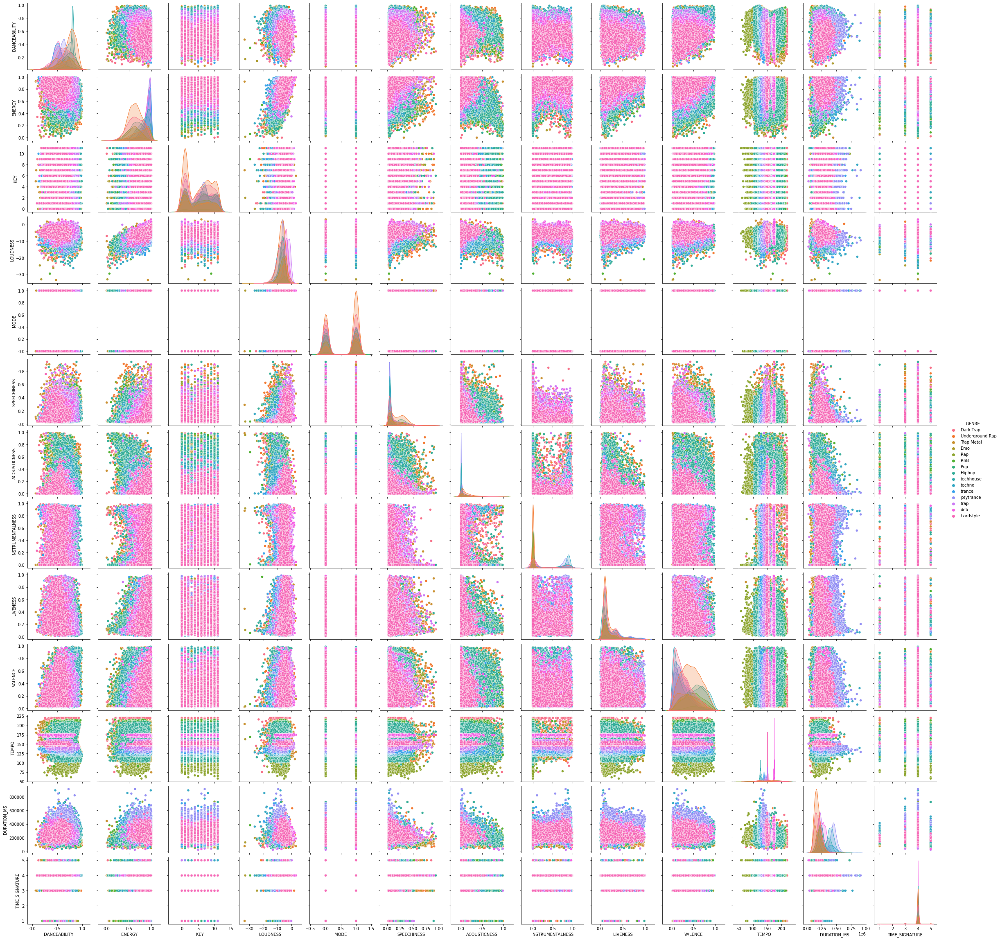

In [ ]:
#Pairplot visualizes given data to find the relationship between them where the
#variables can be continuous or categorical. Plot pairwise relationships in a
#data-set. Pairplot is a module of seaborn library which provides a high-level
#interface for drawing attractive and informative statistical graphics.

sns.pairplot(df,hue='GENRE')

**Groupby different musical features to the genres and show their minimum and maximum values**

In [ ]:
df.groupby(['GENRE'])['DANCEABILITY','ENERGY','KEY','LOUDNESS','MODE','SPEECHINESS','ACOUSTICNESS','INSTRUMENTALNESS','LIVENESS','VALENCE','TEMPO','TIME_SIGNATURE'].agg([np.max,np.min])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



DANCEABILITY         ENERGY  ...    TEMPO TIME_SIGNATURE     
                        amax    amin   amax  ...     amin           amax amin
GENRE                                        ...                             
Dark Trap              0.985  0.0979  0.998  ...   75.418              5    1
Emo                    0.926  0.1110  0.995  ...   87.018              5    1
Hiphop                 0.988  0.1970  0.978  ...   95.622              5    1
Pop                    0.935  0.2090  0.977  ...  106.960              5    1
Rap                    0.981  0.2410  0.980  ...   57.967              5    1
RnB                    0.978  0.1910  0.974  ...   91.560              5    1
Trap Metal             0.985  0.0651  0.999  ...   74.716              5    1
Underground Rap        0.985  0.2410  0.997  ...   95.622              5    1
dnb                    0.855  0.1380  0.999  ...  169.857              5    1
hardstyle              0.774  0.0891  0.999  ...  143.803              5    1
psytrance              0.925  0.2900  0.999  ...  128.008              5    3
techhouse              0.988  0.3680  0.999  ...  119.900              5    1
techno                 0.978  0.2540  1.000  ...  120.001              5    1
trance                 0.887  0.1210  1.000  ...  125.000              5    3
trap                   0.935  0.1500  1.000  ...  135.019              5    1

[15 rows x 24 columns]

**Groupby different musical features to the genres and show their median and mean values**

In [ ]:
df.groupby('GENRE').agg({'DANCEABILITY': ['median', 'mean'], 'ENERGY': ['mean','median'],'KEY': ['median', 'mean'],'LOUDNESS': ['median', 'mean'],'MODE': ['median', 'mean'],'SPEECHINESS': ['median', 'mean'],'ACOUSTICNESS': ['median', 'mean'],'INSTRUMENTALNESS': ['median', 'mean'],'LIVENESS': ['median', 'mean'],'VALENCE': ['median', 'mean'],'TEMPO': ['median', 'mean'],'TIME_SIGNATURE': ['median', 'mean']})

DANCEABILITY            ... TIME_SIGNATURE          
                      median      mean  ...         median      mean
GENRE                                   ...                         
Dark Trap              0.624  0.618800  ...              4  3.961328
Emo                    0.491  0.493699  ...              4  3.938690
Hiphop                 0.717  0.698982  ...              4  3.975561
Pop                    0.687  0.676807  ...              4  3.984816
Rap                    0.757  0.742877  ...              4  3.985931
RnB                    0.688  0.674206  ...              4  3.960934
Trap Metal             0.670  0.647564  ...              4  3.953476
Underground Rap        0.766  0.744658  ...              4  3.979915
dnb                    0.517  0.520944  ...              4  3.998314
hardstyle              0.489  0.478027  ...              4  3.964237
psytrance              0.621  0.617462  ...              4  3.961499
techhouse              0.802  0.786794  ...              4  3.993277
techno                 0.729  0.715742  ...              4  3.945873
trance                 0.506  0.507724  ...              4  3.985995
trap                   0.598  0.593180  ...              4  3.987948

[15 rows x 24 columns]

**Groupby different songs with their respective genres and shows their statistical data according to the different musical features**

In [ ]:
df.groupby(['GENRE','SONGS']).describe()

DANCEABILITY            ... TIME_SIGNATURE     
                                               count      mean  ...            75%  max
GENRE     SONGS                                                 ...                    
Dark Trap "Enough."                              1.0  0.412000  ...            4.0  4.0
          "Life"                                 1.0  0.649000  ...            4.0  4.0
          "You said you love me..."              1.0  0.411000  ...            4.0  4.0
          #1 Stunna                              1.0  0.810000  ...            4.0  4.0
          $UICIDEWAVE                            1.0  0.769000  ...            4.0  4.0
...                                              ...       ...  ...            ...  ...
trap      Riddim Dubstep 2017-2018-2019        181.0  0.586978  ...            4.0  5.0
          Riddim Lords                          21.0  0.552143  ...            4.0  4.0
          Riddim or die                        158.0  0.606291  ...            4.0  5.0
          Trap & Bass 2020                      12.0  0.553000  ...            4.0  4.0
          Trap and Bass                         22.0  0.568409  ...            4.0  5.0

[19987 rows x 104 columns]

**Correlation between the different attributes**

In [ ]:
#corr() is used to find the pairwise correlation of all columns in the dataframe.
#Any na values are automatically excluded. For any non-numeric data type columns
#in the dataframe it is ignored.
df.corr()

,DANCEABILITY,ENERGY,KEY,LOUDNESS,MODE,SPEECHINESS,ACOUSTICNESS,INSTRUMENTALNESS,LIVENESS,VALENCE,TEMPO,DURATION_MS,TIME_SIGNATURE
DANCEABILITY,1.000000,-0.323249,-0.012684,-0.216810,0.084397,0.182169,0.069915,-0.067099,-0.196689,0.369865,-0.166010,-0.049786,0.057709
ENERGY,-0.323249,1.000000,0.044730,0.601555,-0.032202,-0.148362,-0.497335,0.303876,0.231754,-0.013521,-0.024502,0.294466,0.039781
KEY,-0.012684,0.044730,1.000000,-0.006772,-0.248264,-0.030621,-0.004943,0.068246,0.002730,0.028580,-0.009777,0.069226,0.008064
LOUDNESS,-0.216810,0.601555,-0.006772,1.000000,-0.004773,0.048021,-0.283876,-0.187914,0.167135,0.080942,0.151531,-0.095968,0.047469
MODE,0.084397,-0.032202,-0.248264,-0.004773,1.000000,0.050250,-0.014510,-0.016386,0.007298,0.022224,-0.012257,-0.031231,-0.009319
SPEECHINESS,0.182169,-0.148362,-0.030621,0.048021,0.050250,1.000000,0.160187,-0.386566,0.057442,0.218839,0.164658,-0.309885,0.021636
ACOUSTICNESS,0.069915,-0.497335,-0.004943,-0.283876,-0.014510,0.160187,1.000000,-0.261902,-0.107234,0.099325,0.055663,-0.246690,-0.049791
INSTRUMENTALNESS,-0.067099,0.303876,0.068246,-0.187914,-0.016386,-0.386566,-0.261902,1.000000,-0.016005,-0.257084,-0.207636,0.603777,-0.010162
LIVENESS,-0.196689,0.231754,0.002730,0.167135,0.007298,0.057442,-0.107234,-0.016005,1.000000,-0.025170,0.028389,0.010574,0.003079
VALENCE,0.369865,-0.013521,0.028580,0.080942,0.022224,0.218839,0.099325,-0.257084,-0.025170,1.000000,0.058433,-0.191115,0.040310


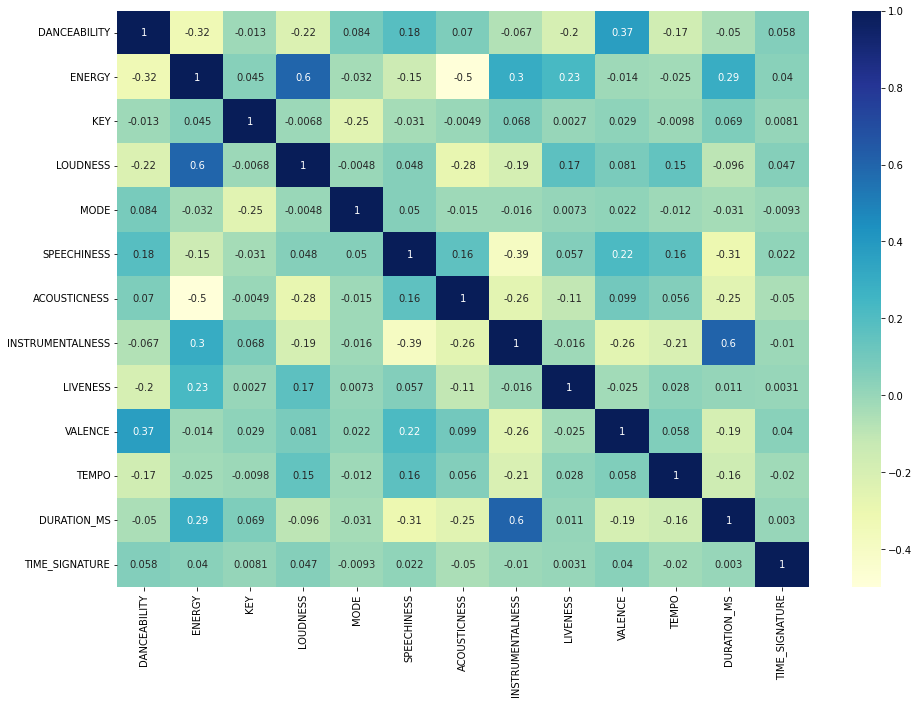

In [ ]:
figure = plt.figure()
axes = figure.add_axes([0,0,2,2])
sns.heatmap(df.corr(), cmap="YlGnBu", annot=True)

# **CONCLUSION**

Acc to the findings from the Spotify Genres dataset:

a> Danceability is usually proportional to energy, therefore songs with high danceability should also have proportional energy

b> Songs have a simple 4/4 time signature which is as it should be.

c> Have vocals in your songs but don't make it too speechy

d> Keeping a high valence i.e. happy, cheerful and/or euphoric is always recommended
